In [26]:
include("Harvey_in_Nelson_funcs.jl")
using .julia


In [27]:
using LinearAlgebra
using Random
using Distributions
using ProgressMeter
using Statistics  
using SpecialFunctions
using NLopt

using Plots
using StatsPlots  
using DataFrames
using XLSX

## Simulate data

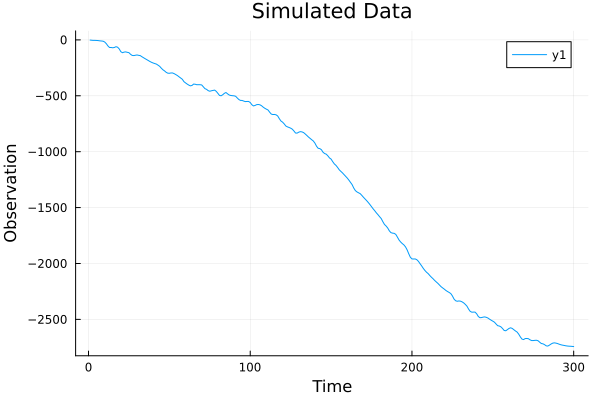

In [28]:
# Define initial state and covariance
n_order = 2  # Adjust based on your model
state_dim = 2 + 2 * n_order
a1 = zeros(state_dim)
P1 = Matrix{Float64}(I(state_dim))*100  # Initial covariance matrix

# True parameters for simulation
rho = 0.6
lambda_c = 0.6
sigma_xi2 = 0.8
sigma_kappa2_0 = 0.5
sigma_kappa2_1 = 1.2
sigma_epsilon2_0 = 0.6
sigma_epsilon2_1 = 1.1
omega = -10
p = 0.4
q = 0.8
# sigma_y = 0.1

params_true = [rho, lambda_c, sigma_xi2, sigma_kappa2_0, sigma_kappa2_1, sigma_epsilon2_0, sigma_epsilon2_1, omega, p, q]

n_obs = 300  # Number of observations

# Simulate data
y, alpha = simulate_data(params_true, n_order, n_obs, a1)


plot(y, title="Simulated Data", xlabel="Time", ylabel="Observation")




In [29]:
Z, T, R, Q_0, Q_1, nu0, nu1, H = state_space(params_true, n_order)
println("Z: ", Z)
println("T: ", T)
println("R: ", R)
println("Q_0: ", Q_0)
println("Q_1: ", Q_1)
println("nu0: ", nu0)
println("nu1: ", nu1)
println("H: ", H)

Z: [1.0, 0.0, 0.0, 0.0, 1.0, 0.0]
T: [1.0 1.0 0.0 0.0 0.0 0.0; 0.0 1.0 0.0 0.0 0.0 0.0; 0.0 0.0 0.49520136894580696 0.3387854840370212 0.0 0.0; 0.0 0.0 -0.3387854840370212 0.49520136894580696 0.0 0.0; 0.0 0.0 1.0 0.0 0.49520136894580696 0.3387854840370212; 0.0 0.0 0.0 1.0 -0.3387854840370212 0.49520136894580696]
R: [1.0 0.0 0.0 0.0 0.0 0.0; 0.0 1.0 0.0 0.0 0.0 0.0; 0.0 0.0 1.0 0.0 0.0 0.0; 0.0 0.0 0.0 1.0 0.0 0.0; 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 0.0 0.0 0.0 0.0 0.0]
Q_0: [0.6 0.0 0.0 0.0 0.0 0.0; 0.0 0.8 0.0 0.0 0.0 0.0; 0.0 0.0 0.5 0.0 0.0 0.0; 0.0 0.0 0.0 0.5 0.0 0.0; 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 0.0 0.0 0.0 0.0 0.0]
Q_1: [1.1 0.0 0.0 0.0 0.0 0.0; 0.0 0.8 0.0 0.0 0.0 0.0; 0.0 0.0 1.2 0.0 0.0 0.0; 0.0 0.0 0.0 1.2 0.0 0.0; 0.0 0.0 0.0 0.0 0.0 0.0; 0.0 0.0 0.0 0.0 0.0 0.0]
nu0: [0.0, 0.0, 0.0, 0.0, 0.0, 0.0]
nu1: [0.0, 0.0, -10.0, -10.0, 0.0, 0.0]
H: 0


In [30]:
logL, a, p_res = switching_kalman_filter(y, params_true, n_order, a1, P1)

(-795.8252651635212, [-0.9148317057425155 -0.4557641820098235 … -0.61983928753336 1.2323748457590735e-18; -0.6722218899798855 -0.041264272489791504 … -2.491150324874 -1.136324732366632; … ; -2742.002011758352 -1.6151413702793553 … 0.6027626669187967 0.5453782698533943; -2744.050629215229 -1.8107297808331886 … 0.6456102475184285 -0.09374346099034597], [0.7501381584900481 0.2498618415099519; 0.7595571146048955 0.24044288539510458; … ; 0.810449809836382 0.18955019016361804; 0.8104396161618906 0.18956038383810944])

## Estimate

In [31]:
#Define model
n_order = n_order
state_dim = 2+2*n_order
alpha_init = zeros(state_dim)
alpha_init[1] = y[1]
P1 = Matrix{Float64}(I(state_dim))*100  # Initial covariance matrix

#Priors
a_rho = 0.01
b_rho = 0.97
a_lambda = 0.01
b_lambda = 0.97
a_xi = 1e-6
b_xi = 1e-6
a_kappa_0 = 1e-6
b_kappa_0 = 1e-6
a_kappa_1 = 1e-6
b_kappa_1 = 1e-6
a_epsilon_0 = 1e-6
b_epsilon_0 = 1e-6
a_epsilon_1 = 1e-6
b_epsilon_1 = 1e-6
a_omega = -100
b_omega = 0
a_p = 0.01
b_p = 0.99
a_q = 0.01
b_q = 0.99
# a_sigma_y = 1e-6
# b_sigma_y = 1e-6
priors = [a_rho, b_rho, a_lambda, b_lambda, a_xi, b_xi, a_kappa_0, b_kappa_0, a_kappa_1, b_kappa_1, a_epsilon_0, b_epsilon_0, a_epsilon_1, b_epsilon_1, a_omega, b_omega, a_p, b_p, a_q, b_q]




20-element Vector{Float64}:
    0.01
    0.97
    0.01
    0.97
    1.0e-6
    1.0e-6
    1.0e-6
    1.0e-6
    1.0e-6
    1.0e-6
    1.0e-6
    1.0e-6
    1.0e-6
    1.0e-6
 -100.0
    0.0
    0.01
    0.99
    0.01
    0.99

In [32]:
# Run MCMC initialization
chain_init_burned, Sigma, acceptance_rate_init, chain_init = initialize_mcmc(
    y,
    priors,
    alpha_init, 
    P1, 
    n_order; 
    n_init=40000, 
    burn_init=20000, 
    omega_init=0.001)

Initialization Phase 100%|███████████████████████████████| Time: 0:05:52


Initialization Acceptance Rate: 46.0175 %


([0.4705761340566854 0.3466645043635164 … -0.5648344668654806 1.803314561815134; 0.4705761340566854 0.3466645043635164 … -0.5648344668654806 1.803314561815134; … ; 0.46431985060534137 0.3568055675957769 … -0.31923498730625455 1.3801888104457718; 0.46431985060534137 0.3568055675957769 … -0.31923498730625455 1.3801888104457718], [0.0007642009662162831 8.978761228943257e-5 … -0.0005817546084712159 7.182776983310474e-5; 8.978761228943257e-5 0.002463168304708169 … -0.0005582381216894591 -0.0002842219613134616; … ; -0.0005817546084712159 -0.0005582381216894591 … 0.07064965454412243 0.0072497912907693715; 7.182776983310474e-5 -0.0002842219613134616 … 0.0072497912907693715 0.025128060095898817], 0.460175, [0.0 0.0 … 0.0 0.0; 0.06720009398258463 0.03244425366486266 … 0.007775903212154872 0.016478737222802783; … ; 0.46431985060534137 0.3568055675957769 … -0.31923498730625455 1.3801888104457718; 0.46431985060534137 0.3568055675957769 … -0.31923498730625455 1.3801888104457718])

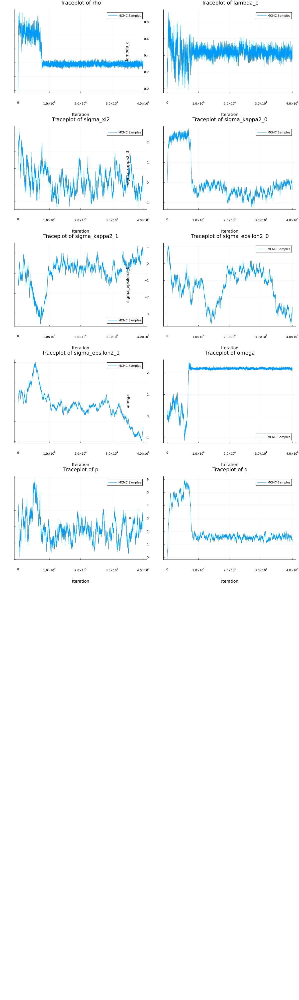

In [33]:
parameters = ["rho", "lambda_c", "sigma_xi2", "sigma_kappa2_0", "sigma_kappa2_1",
              "sigma_epsilon2_0", "sigma_epsilon2_1", "omega", "p", "q"]

n_params = length(parameters)

# Initialize a list to hold the plots
p_list = []

for i in 1:n_params
    param_samples_init = chain_init[:, i]
    
    
    # Traceplot of MCMC samples
    p2 = plot(param_samples_init, label="MCMC Samples", xlabel="Iteration", ylabel=parameters[i],
              title="Traceplot of $(parameters[i])")

    
    # Add plots to the list
    push!(p_list, p2)
end

# Display the plots in a grid layout
nrows = n_params
ncols = 2
plot(p_list..., layout=(nrows, ncols), size=(1200, 400 * n_params))


In [44]:
# Run MCMC recursion
theta_samples_burned, alpha_samples, acceptance_rate_rec, p_res = recursion_mcmc(
    y, 
    priors,
    alpha_init, 
    P1, 
    n_order, 
    chain_init_burned, 
    Sigma; 
    n_rec=20000, 
    burn_rec=10000, 
    omega_rec=0.05)


Recursion Phase 100%|████████████████████████████████████| Time: 0:04:42


Recursion Acceptance Rate: 68.26 %


([0.6010092872325409 0.5865005993806091 … 0.3554313925868598 0.8143032305003648; 0.6012073430909519 0.5836624541359512 … 0.34294857693677866 0.8155408888463493; … ; 0.608347861436995 0.5795592701271743 … 0.3858330405872186 0.8385770287267822; 0.6089086581506605 0.5765953790016848 … 0.38013741479196295 0.8425182708968316], Any[[-1.5346709932758757 0.0 … 0.0 0.0; -1.397383727224618 0.08184930953517136 … -1.7659884876292673 -1.6781251661032819; … ; -2742.0028725838515 -1.6197226440143044 … 0.6036234924186273 0.5995205745879412; -2744.085136238613 -1.8346043239188827 … 0.6801172709025922 -0.08430782119416885], [-1.5346709932758755 0.0 … 0.0 0.0; -1.349832531403083 0.11025661799797778 … -1.8135396834508013 -1.6943137320675234; … ; -2742.00521703961 -1.618525703854838 … 0.6059679481776784 0.5983169553417084; -2744.0865547925855 -1.8331021181441587 … 0.6815358248752141 -0.08608867760888758], [-1.5346709932758757 0.0 … 0.0 0.0; -1.3801141073314152 0.09231877740176009 … -1.7832581075224692 -1.6

In [45]:


# Number of optimization runs
num_runs = 1

# Parameter names to associate with priors
parameters = ["rho", "lambda_c", "sigma_xi2", "sigma_kappa2_0", "sigma_kappa2_1",
              "sigma_epsilon2_0", "sigma_epsilon2_1", "omega", "p", "q"]

upper_bounds = [1.0, 2 * π, Inf, Inf, Inf, Inf, Inf, Inf, 1.0, 1.0]
lower_bounds = [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, -Inf, 0.0, 0.0]

              
# Function to generate initial parameters from specified priors
function draw_initial_params(parameters)
    initial_params = Float64[]  # Enforce Float64 type for the parameters
    for param in parameters
        if param == "rho"
            # Uniform prior between 0 and 0.999
            push!(initial_params, rand(Uniform(0.001, 0.999)))
        elseif param == "lambda_c"
            # Uniform prior between 0 and π
            push!(initial_params, rand(Uniform(0.001, π)))
        elseif param in ["p", "q"]
            # Uniform prior between 0 and 1
            push!(initial_params, rand(Uniform(0.01, 0.99)))
        elseif param == "omega"
            # Normal prior with mean -0.5 and std 0.1
            push!(initial_params, rand(Normal(-0.5, 0.5)))
        else
            # Inverse-Gamma prior
            push!(initial_params, rand(InverseGamma(3, 1)))
        end
    end
    return initial_params
end

# Define the objective function
function obj(params::Vector, grad::Vector)
    try
        return neg_log_likelihood(params, y, alpha_init, P1, n_order)
    catch e
        return 1e10  # Return a large number in case of error
    end
end

# Run optimization with multiple initial guesses

best_minf = Inf
best_params = nothing

pb = Progress(num_runs; desc="MLE Optimization")
for run in 1:num_runs
    
    # Draw a new set of initial parameters from priors
    initial_params = draw_initial_params(parameters)

    # Create the optimizer
    opt = Opt(:LN_NELDERMEAD, length(initial_params))
    opt.lower_bounds = lower_bounds
    opt.upper_bounds = upper_bounds
    opt.min_objective = obj
    opt.maxeval = 10000
    opt.xtol_rel = 1e-6

    # Run the optimization
    (minf, estimated_params, ret) = NLopt.optimize(opt, initial_params)
 
    # Save the best result
    if minf < best_minf
        best_minf = minf
        best_params = estimated_params
    end

    next!(pb)
end


# Display the best estimated parameters
println("Best Estimated Parameters: ", best_params)


Best Estimated Parameters: [0.6050714759082779, 0.5988601812523087, 0.7746121003446274, 0.4776597132790144, 1.025061572977922, 0.5899423677436639, 0.28185440722750366, -9.841331859341324, 0.47976465980084443, 0.7800050363419673]


In [46]:
parameters = ["rho", "lambda_c", "sigma_xi2", "sigma_kappa2_0", "sigma_kappa2_1",
              "sigma_epsilon2_0", "sigma_epsilon2_1", "omega", "p", "q"]

n_params = length(parameters)

10

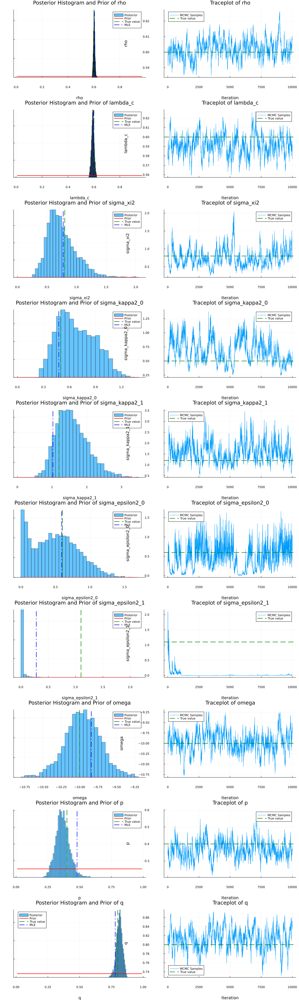

In [47]:
# Initialize a list to hold the plots
p_list = []

for i in 1:n_params
    param_samples = theta_samples_burned[:, i]
    
    # Histogram of posterior samples
    p1 = histogram(param_samples, bins=50, normalize=true, alpha=0.6,
                   label="Posterior", xlabel=parameters[i], ylabel="Density",
                   title="Posterior Histogram and Prior of $(parameters[i])")
    
    # Define the prior distribution
    if parameters[i] == "rho"
        # Uniform prior between 0 and 0.999
        a = a_rho
        b = b_rho
        x_values = range(a, b, length=200)
        prior_pdf = pdf.(Uniform(a, b), x_values)
    elseif parameters[i] == "lambda_c"
        # Uniform prior between 0 and π
        a = a_lambda
        b = b_lambda
        x_values = range(a, b, length=200)
        prior_pdf = pdf.(Uniform(a, b), x_values)
    elseif parameters[i] in ["p", "q"]
        # Uniform prior between 0 and 1
        a = a_p
        b = 1b_p
        x_values = range(a, b, length=200)
        prior_pdf = pdf.(Uniform(a, b), x_values)
    elseif parameters[i] == "omega"
        a = a_omega
        b = b_omega
        x_values = range(minimum(param_samples), maximum(param_samples), length=200)
        prior_pdf = pdf.(Normal(a, b), x_values)
    elseif parameters[i] == "sigma_xi2"
        a = a_xi
        b = b_xi
        x_values = range(0, maximum(param_samples), length=200)
        prior_pdf = pdf.(InverseGamma(a, b), x_values)
    elseif parameters[i] == "sigma_kappa2_0"
        a = a_kappa_0
        b = b_kappa_0
        x_values = range(0, maximum(param_samples), length=200)
        prior_pdf = pdf.(InverseGamma(a, b), x_values)
    elseif parameters[i] == "sigma_kappa2_1"
        a = a_kappa_1
        b = b_kappa_1
        x_values = range(0, maximum(param_samples), length=200)
        prior_pdf = pdf.(InverseGamma(a, b), x_values)
    elseif parameters[i] == "sigma_epsilon2_0"
        a = a_epsilon_0
        b = b_epsilon_0
        x_values = range(0, maximum(param_samples), length=200)
        prior_pdf = pdf.(InverseGamma(a, b), x_values)
    elseif parameters[i] == "sigma_epsilon2_1"
        a = a_epsilon_1
        b = b_epsilon_1
        x_values = range(0, maximum(param_samples), length=200)
        prior_pdf = pdf.(InverseGamma(a, b), x_values)
    elseif parameters[i] == "sigma_y"
        a = a_sigma_y
        b = b_sigma_y
        x_values = range(0, maximum(param_samples), length=200)
        prior_pdf = pdf.(InverseGamma(a, b), x_values)
    end
    
    # Overlay prior PDF on histogram
    plot!(p1, x_values, prior_pdf, label="Prior", color=:red, linewidth=2)
    
    # Include true parameter value
    vline!(p1, [params_true[i]], label="True value", color=:green, linestyle=:dash, linewidth=2)
    
    #MLE estimates
    vline!(p1, [best_params[i]], label="MLE", color=:blue, linestyle=:dashdot, linewidth=2)
    
    # Traceplot of MCMC samples
    p2 = plot(param_samples, label="MCMC Samples", xlabel="Iteration", ylabel=parameters[i],
              title="Traceplot of $(parameters[i])")
    hline!(p2, [params_true[i]], label="True value", color=:green, linestyle=:dash, linewidth=2)
    
    # Add plots to the list
    push!(p_list, p1)
    push!(p_list, p2)
end

# Display the plots in a grid layout
nrows = n_params
ncols = 2
plot(p_list..., layout=(nrows, ncols), size=(1200, 400 * n_params))


In [48]:
# Calculate means of posterior samples
chain_rec_burned_means = mean(theta_samples_burned, dims=1)  # 1 x n_params array
chain_rec_burned_means = vec(chain_rec_burned_means)  # Convert to a vector


10-element Vector{Float64}:
  0.6019919418244477
  0.5915832828257409
  0.7502896602894917
  0.6799700279416125
  1.5786073475004523
  0.49311206916263434
  0.02735396684459271
 -9.957650681955915
  0.3662592741339373
  0.8129551176444085

In [49]:

# Create the DataFrame
data = DataFrame(Dict(
    "Parameter" => parameters,
    "MCMC Estimate" => chain_rec_burned_means,
    "MLE Estimate" => best_params,  # Include if available
    "True Value" => params_true
))

# Display the DataFrame
display(data)


Row,MCMC Estimate,MLE Estimate,Parameter,True Value
,Float64,Float64,String,Float64
1,0.601992,0.605071,rho,0.6
2,0.591583,0.59886,lambda_c,0.6
3,0.75029,0.774612,sigma_xi2,0.8
4,0.67997,0.47766,sigma_kappa2_0,0.5
5,1.57861,1.02506,sigma_kappa2_1,1.2
6,0.493112,0.589942,sigma_epsilon2_0,0.6
7,0.027354,0.281854,sigma_epsilon2_1,1.1
8,-9.95765,-9.84133,omega,-10.0
9,0.366259,0.479765,p,0.4


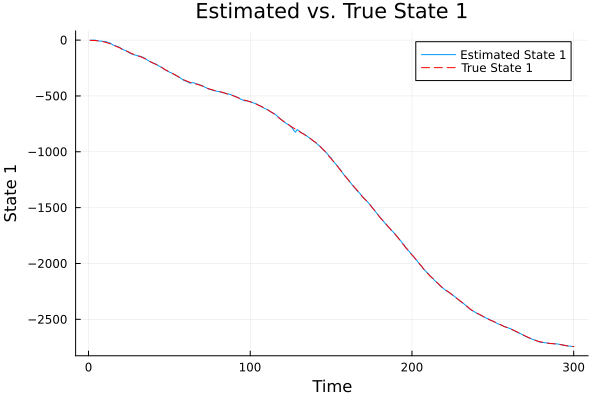

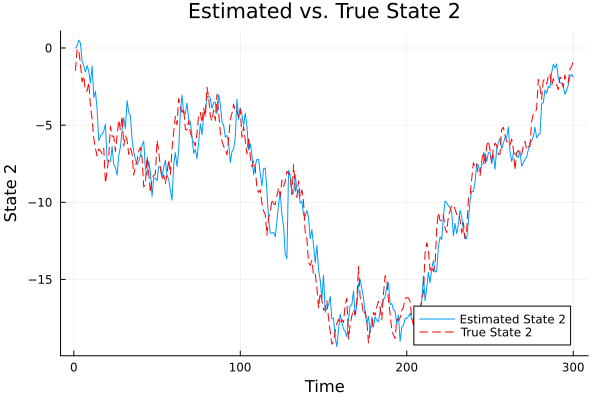

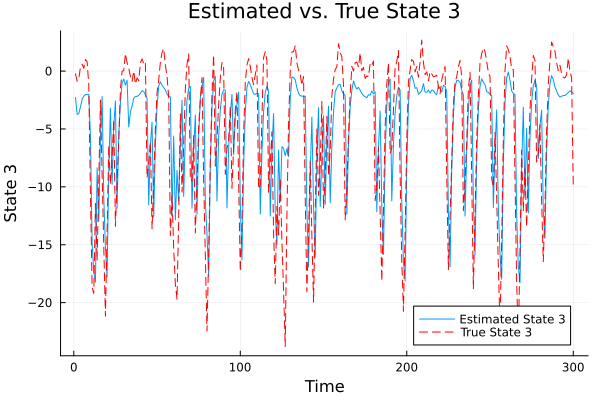

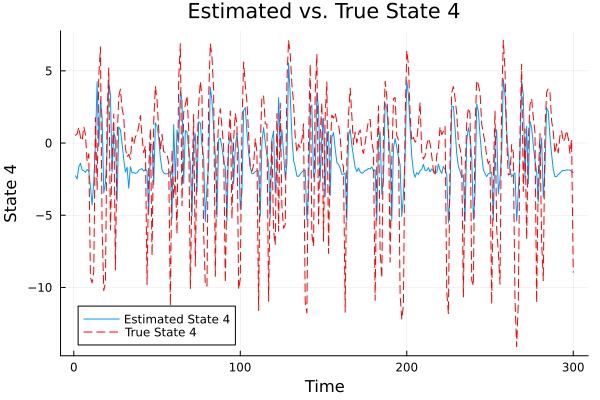

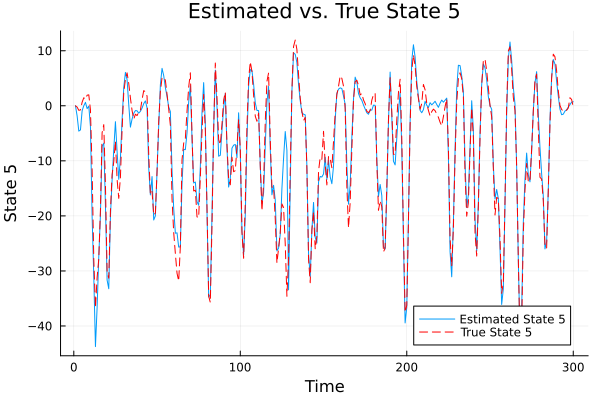

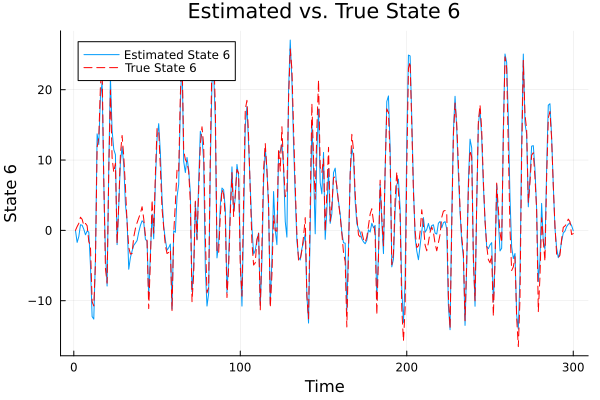

In [50]:


n_samples = length(alpha_samples)
n_time_steps = size(alpha_samples[1], 1)
state_dim = size(alpha_samples[1], 2)

# Initialize array to hold alpha samples
alpha_samples_array = Array{Float64}(undef, n_samples, n_time_steps, state_dim)
# Collect alpha samples into a 3D array
for i in 1:n_samples
    alpha_samples_array[i, :, :] = alpha_samples[i]
end



# Compute posterior mean over samples (dimension 1)
alpha_mean = mean(alpha_samples_array, dims=1)  # 1 x n_time_steps x state_dim
alpha_mean = dropdims(alpha_mean; dims=1)  # n_time_steps x state_dim

# Compute credible intervals
alpha_lower = mapslices(x -> quantile(x, 0.025), alpha_samples_array; dims=1)
alpha_lower = dropdims(alpha_lower; dims=1)
alpha_upper = mapslices(x -> quantile(x, 0.975), alpha_samples_array; dims=1)
alpha_upper = dropdims(alpha_upper; dims=1)



time = 1:n_time_steps

for s in 1:state_dim
    p = plot(time, alpha_mean[:, s], label="Estimated State $(s)", xlabel="Time",
             ylabel="State $(s)", title="Estimated vs. True State $(s)")
    
    # Add credible intervals using the `ribbon` argument
    # plot!(time, alpha_mean[:, s], ribbon=(alpha_mean[:, s] .- alpha_lower[:, s],
    #       alpha_upper[:, s] .- alpha_mean[:, s]), fillalpha=0.3, label="95% Credible Interval")
    
    # Plot true state (assuming you have `alpha_true` from data simulation)
    plot!(time, alpha[1:n_time_steps, s], label="True State $(s)", linestyle=:dash, color=:red)
    
    display(p)
end


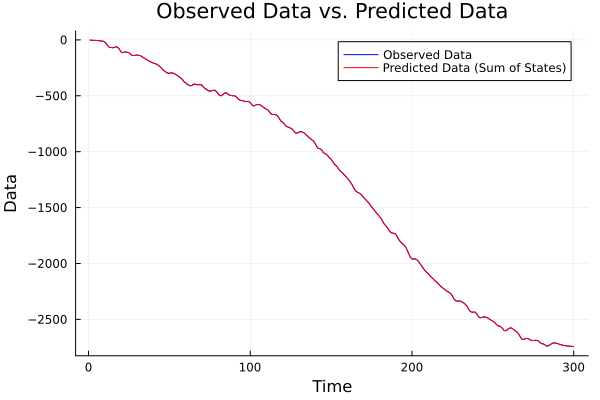

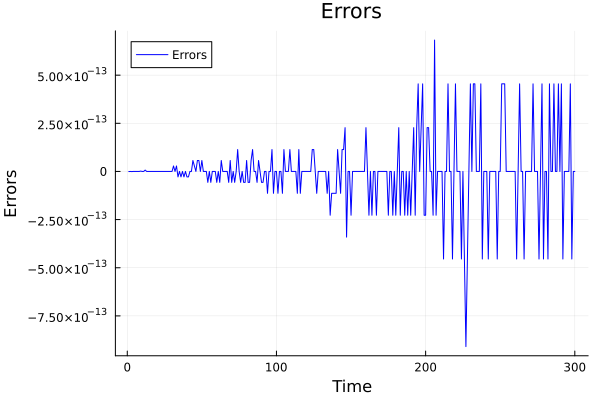

In [51]:
# Compute y_pred
state_indices = [1, 2 + 2 * n_order-1]  # Adjust as necessary

y_pred = alpha_mean[:, state_indices[1]] .+ alpha_mean[:, state_indices[2]]

time = 1:length(y_pred)
y_adjusted = y[1:length(y_pred)]  # Adjust if lengths differ

p = plot(time, y_adjusted, label="Observed Data", color=:blue)
plot!(p, time, y_pred, label="Predicted Data (Sum of States)", color=:red)
xlabel!("Time")
ylabel!("Data")
title!("Observed Data vs. Predicted Data")
display(p)


errors = y_adjusted .- y_pred

p_error = plot(time, errors, label="Errors", color=:blue)
xlabel!("Time")
ylabel!("Errors")
title!("Errors")
display(p_error)


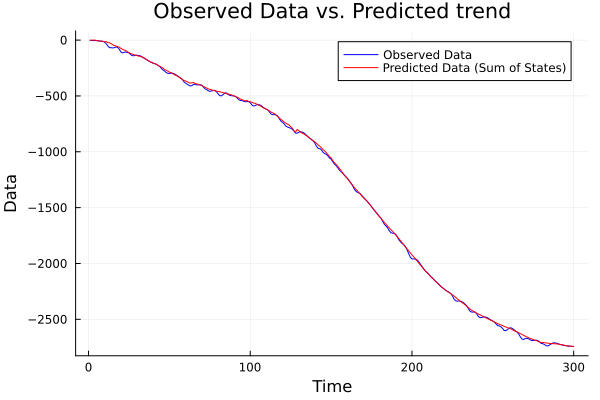

In [52]:
# estimated state 1 and true observation y
# Compute y_pred
state_indices = [1, 2 + 2 * n_order-1]  # Adjust as necessary

y_pred = alpha_mean[:, state_indices[1]] 

time = 1:length(y_pred)
y_adjusted = y[1:length(y_pred)]  # Adjust if lengths differ

p = plot(time, y_adjusted, label="Observed Data", color=:blue)
plot!(p, time, y_pred, label="Predicted Data (Sum of States)", color=:red)
xlabel!("Time")
ylabel!("Data")
title!("Observed Data vs. Predicted trend")
display(p)





In [53]:


# n_samples = length(p_res)
# n_time_steps = size(p_res[1], 1)

# # Initialize array to hold alpha samples
# p_res_array = Array{Float64}(undef, n_samples, n_time_steps)
# # Collect alpha samples into a 3D array
# for i in 1:n_samples
#     p_res_array[i, :, ] = p_res[i]
# end



# # Compute posterior mean over samples (dimension 1)
# p_res_mean = mean(p_res_array, dims=1)  # 1 x n_time_steps x state_dim
# println(p_res_mean)

# # Compute credible intervals
# p_lower = mapslices(x -> quantile(x, 0.025), p_res_array; dims=1)

# p_upper = mapslices(x -> quantile(x, 0.975), p_res_array; dims=1)




# time = 1:n_time_steps


# p = plot(time, p_res_mean, label="Estimated prob of recesion", xlabel="Time",
#         ylabel="p", title="Estimated prob of recesion")
    
#     # Add credible intervals using the `ribbon` argument
#     # plot!(time, p_res_mean, ribbon=(p_res_mean .- p_lower,
#     #       p_upper .- p_res_mean_mean), fillalpha=0.3, label="95% Credible Interval")
    
    
#     display(p)
# end
